# 2023-10-31

# Testing Data Output from HackEEG

In [1]:
import os
from pathlib import Path
import sys

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scienceplots
from scipy.fft import fft

current_folder = globals()['_dh'][0]

sys.path.insert(1, str(Path(current_folder).resolve().parents[0]))
sys.path.insert(0, str("".join((str(current_folder.resolve().parents[0]),'/data/'))))

import hackeeg
import hackeeg.analysis as han
from hackeeg.multi_melt import multi_melt

sns.set_context('notebook')
sns.set_style("white")
plt.style.use(['science', 'notebook'])


In [ ]:
# print list of files found in current sys path
print("Files found in sys path:")
for file in os.listdir(sys.path[0]):
    print(file)

In [2]:
file_name = "".join((sys.path[0],'/2023-10-12_14-37-08_data.parquet'))
# file_name = '/Users/leonardofortaleza/Library/CloudStorage/OneDrive-McGillUniversity/Documents McGill/TIMS/Experiments/2023-10-26/2023-10-26_17-18-45_baseline-0-1-01-0-00.parquet'
df = pd.read_parquet(file_name)
df = hackeeg.process_df(df, sample_counter= 16000, duration=2, scale=1e-3, gain=1)
df.head()

,C,D,timestamp,sample_number,ads_status,ads_gpio,loff_statn,loff_statp,extra,channel_data,...,ch04,raw_ch05,ch05,raw_ch06,ch06,raw_ch07,ch07,raw_ch08,ch08,ch_unit
0,200,b'\xf1Q\xad\xea\x01\x00\x00\x00\xc0\x00\x00\xf...,3937227249,1,12582912,0,0,0,12,"[-189475, -546370, -125880, -54245, -23690, -9...",...,-376.212515,-23690,-375.529558,-90945,-377.032824,-22990,-375.513911,-242850,-380.428166,mV
1,200,b'0R\xad\xea\x02\x00\x00\x00\xc0\x00\x00\xfd\x...,3937227312,2,12582912,0,0,0,12,"[-189660, -546555, -126010, -54250, -23675, -9...",...,-376.212627,-23675,-375.529222,-90885,-377.031483,-23075,-375.515811,-242930,-380.429954,mV
2,200,b'kR\xad\xea\x03\x00\x00\x00\xc0\x00\x00\xfd\x...,3937227371,3,12582912,0,0,0,12,"[-189725, -546590, -126035, -54285, -23715, -9...",...,-376.213409,-23715,-375.530116,-91100,-377.036289,-23120,-375.516817,-242855,-380.428278,mV
3,200,b'\xaaR\xad\xea\x04\x00\x00\x00\xc0\x00\x00\xf...,3937227434,4,12582912,0,0,0,12,"[-189910, -546760, -126025, -54325, -23635, -9...",...,-376.214303,-23635,-375.528328,-91055,-377.035283,-23155,-375.517599,-242925,-380.429842,mV
4,200,b'\xe8R\xad\xea\x05\x00\x00\x00\xc0\x00\x00\xf...,3937227496,5,12582912,0,0,0,12,"[-189985, -546835, -126055, -54390, -23660, -9...",...,-376.215756,-23660,-375.528887,-91180,-377.038077,-23125,-375.516929,-242925,-380.429842,mV


In [4]:
df.columns

Index(['C', 'D', 'timestamp', 'sample_number', 'ads_status', 'ads_gpio',
       'loff_statn', 'loff_statp', 'extra', 'channel_data', 'data_hex',
       'data_raw', 'total_samples', 'total_duration', 'avg_sample_rate',
       'gain', 'num_chs', 'raw_ch01', 'ch01', 'raw_ch02', 'ch02', 'raw_ch03',
       'ch03', 'raw_ch04', 'ch04', 'raw_ch05', 'ch05', 'raw_ch06', 'ch06',
       'raw_ch07', 'ch07', 'raw_ch08', 'ch08', 'ch_unit'],
      dtype='object')

In [ ]:
df = hackeeg.process_df(df, sample_counter= 16000, duration=2, scale=1e-3, gain=1)

<Axes: title={'center': '2023-10-12_14-37-08_data'}, xlabel='sample_number'>

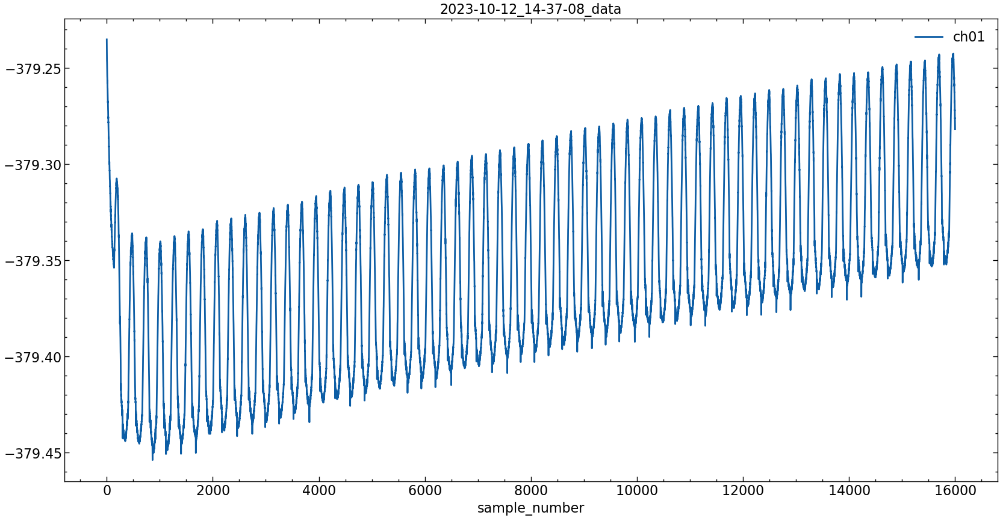

In [6]:
df.plot(x='sample_number', y='ch01', figsize=(20,10), title='2023-10-12_14-37-08_data')

In [ ]:
# lineplot of df with seaborn
sns.lineplot(data=df.loc[df.sample_number.between(2000,4000)], x='sample_number', y='ch01', legend=False)

In [ ]:
sns.scatterplot(data=df.loc[df.sample_number.between(2000,4000)], x='sample_number', y='ch01', legend=False)

Text(0, 0.5, 'Amplitude')

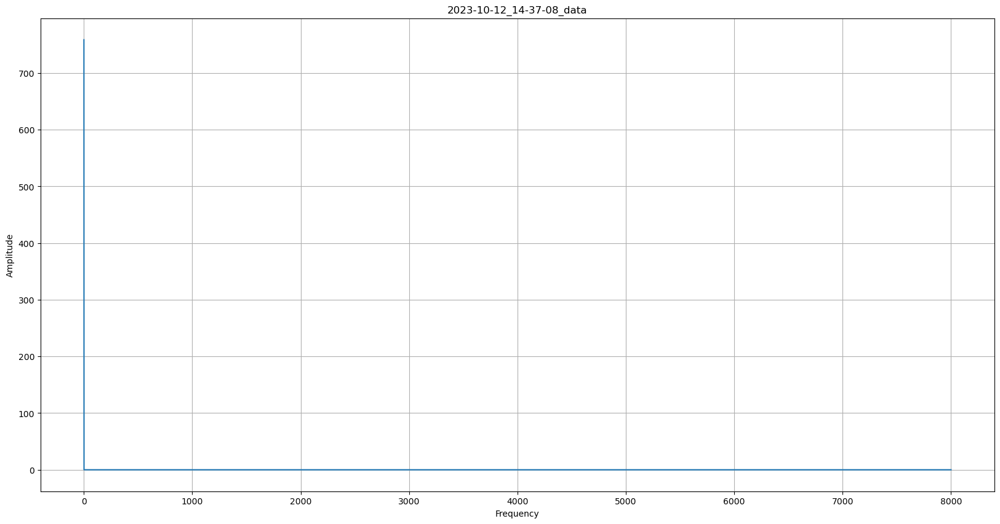

In [7]:
#plot fft of data in ch01
from scipy.fftpack import fft
from scipy import signal
from scipy.signal import butter, lfilter, freqz

# Number of sample points
N = 16000
# sample spacing
T = 1.0 / 16000.0
y = df['sample_number']
yf = fft(df['ch01'].values)
xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
plt.figure(figsize=(20,10))
plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]), label='ch01')
plt.grid()
plt.title('2023-10-12_14-37-08_data')
plt.xlabel('Frequency')
plt.ylabel('Amplitude')

(0.0, 500.0)

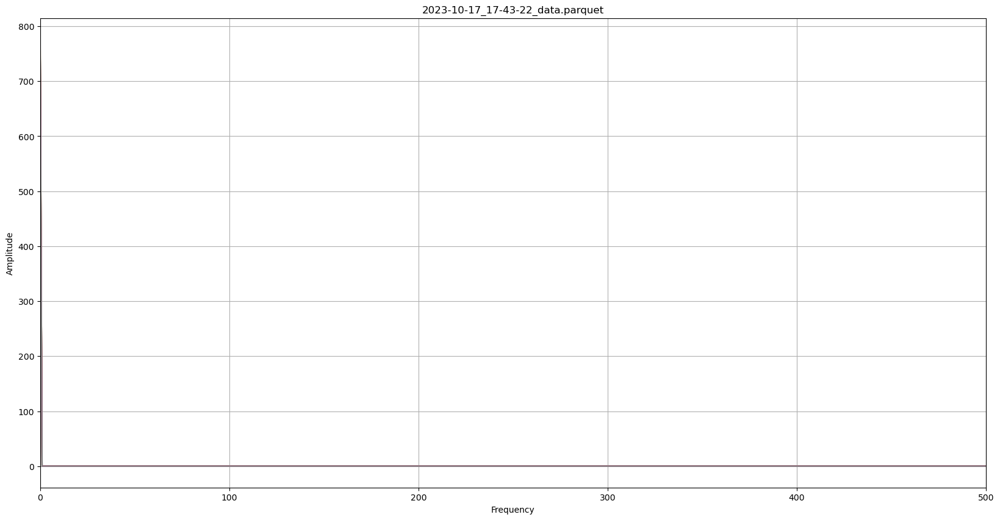

In [8]:
#plot fft of data in ch01
from scipy.fftpack import fft
from scipy import signal
from scipy.signal import butter, lfilter, freqz

# Number of sample points
N = 16000
# sample spacing
T = 1.0 / 16000.0
y = df['sample_number']
yf1 = fft(df['ch01'].values)
yf2 = fft(df['ch02'].values)
yf3 = fft(df['ch03'].values)
yf4 = fft(df['ch04'].values)
yf5 = fft(df['ch05'].values)
yf6 = fft(df['ch06'].values)
yf7 = fft(df['ch07'].values)
yf8 = fft(df['ch08'].values)

xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
plt.figure(figsize=(20,10))
plt.plot(xf, 2.0/N * np.abs(yf1[0:N//2]), label='ch01')
plt.plot(xf, 2.0/N * np.abs(yf2[0:N//2]), label='ch02')
plt.plot(xf, 2.0/N * np.abs(yf3[0:N//2]), label='ch03')
plt.plot(xf, 2.0/N * np.abs(yf4[0:N//2]), label='ch04')
plt.plot(xf, 2.0/N * np.abs(yf5[0:N//2]), label='ch05')
plt.plot(xf, 2.0/N * np.abs(yf6[0:N//2]), label='ch06')
plt.plot(xf, 2.0/N * np.abs(yf7[0:N//2]), label='ch07')
plt.plot(xf, 2.0/N * np.abs(yf8[0:N//2]), label='ch08')
plt.grid()
plt.title('2023-10-17_17-43-22_data.parquet')
plt.xlabel('Frequency')
plt.ylabel('Amplitude')
plt.xlim(0, 500)

(0.0, 0.5)

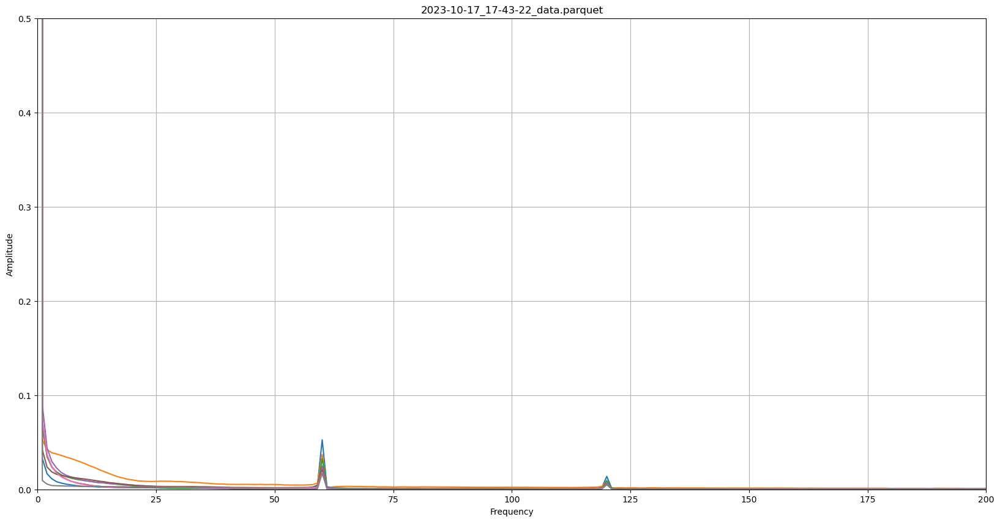

In [9]:
#plot fft of data in ch01
from scipy.fftpack import fft
from scipy import signal
from scipy.signal import butter, lfilter, freqz

# Number of sample points
N = 16000
# sample spacing
T = 1.0 / 16000.0
y = df['sample_number']
yf1 = fft(df['ch01'].values)
yf2 = fft(df['ch02'].values)
yf3 = fft(df['ch03'].values)
yf4 = fft(df['ch04'].values)
yf5 = fft(df['ch05'].values)
yf6 = fft(df['ch06'].values)
yf7 = fft(df['ch07'].values)
yf8 = fft(df['ch08'].values)

xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
plt.figure(figsize=(20,10))
plt.plot(xf, 2.0/N * np.abs(yf1[0:N//2]), label='ch01')
plt.plot(xf, 2.0/N * np.abs(yf2[0:N//2]), label='ch02')
plt.plot(xf, 2.0/N * np.abs(yf3[0:N//2]), label='ch03')
plt.plot(xf, 2.0/N * np.abs(yf4[0:N//2]), label='ch04')
plt.plot(xf, 2.0/N * np.abs(yf5[0:N//2]), label='ch05')
plt.plot(xf, 2.0/N * np.abs(yf6[0:N//2]), label='ch06')
plt.plot(xf, 2.0/N * np.abs(yf7[0:N//2]), label='ch07')
plt.plot(xf, 2.0/N * np.abs(yf8[0:N//2]), label='ch08')
plt.grid()
plt.title('2023-10-17_17-43-22_data.parquet')
plt.xlabel('Frequency')
plt.ylabel('Amplitude')
plt.xlim(0, 200)
plt.ylim(0,0.5)

In [ ]:
dftest = df.pipe(multi_melt, 
                id_vars=['C', 'D', 'timestamp', 'sample_number', 'ads_status', 'ads_gpio',
                        'loff_statn', 'loff_statp', 'extra', 'channel_data', 'data_hex',
                        'data_raw', 'total_samples', 'total_duration', 'avg_sample_rate',
                        'gain','ch_unit'],
                 value_vars=[[f'ch{i:02d}' for i in np.arange(1, len(df.loc[0, 'channel_data'])+1)],
                            [f'raw_ch{i:02d}' for i in np.arange(1, len(df.loc[0, 'channel_data'])+1)]],
                 var_name=['ch','raw_ch'],
                 value_name=['voltage','raw_voltage'])
dftest.head()

In [23]:
df2 = han.extract_data_from_df(df, errors='ignore')
df2 = han.wide2long_eeg(df2, value_vars_primitives=['ch','raw_ch'], value_names=['voltage','raw_voltage'],
                id_vars = ['timestamp', 'sample_number', 'total_samples', 'total_duration', 'avg_sample_rate',
                    'gain', 'ch_unit', 'num_chs'],
                rename_ch2int=True)

In [5]:
df2.head()

,timestamp,sample_number,total_duration,avg_sample_rate,gain,ch_unit,num_chs,level_7,ch,voltage,raw_voltage
0,3937227249,1,2,8000.0,1,mV,8,0,1,-379.235141,-189475
1,3937227249,1,2,8000.0,1,mV,8,1,2,-387.212367,-546370
2,3937227249,1,2,8000.0,1,mV,8,2,3,-377.813682,-125880
3,3937227249,1,2,8000.0,1,mV,8,3,4,-376.212515,-54245
4,3937227249,1,2,8000.0,1,mV,8,4,5,-375.529558,-23690


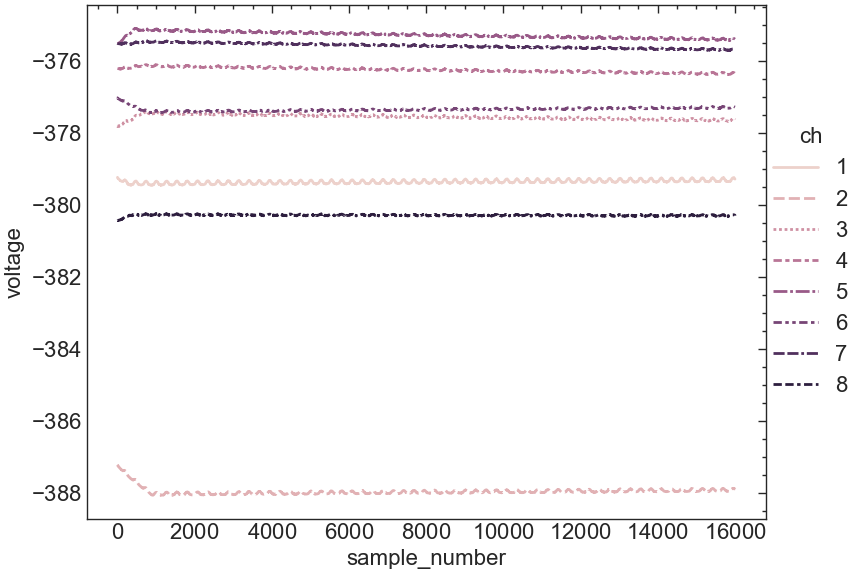

In [32]:
ax = sns.lineplot(data=df2, x='sample_number', y='voltage', hue='ch', style='ch', legend='full')
plt.tight_layout()
sns.move_legend(ax, "center right", bbox_to_anchor=(1.15, 0.5), ncol=1)

In [7]:
df2.ch.unique()

array([1, 2, 3, 4, 5, 6, 7, 8])

<Axes: xlabel='sample_number', ylabel='voltage'>

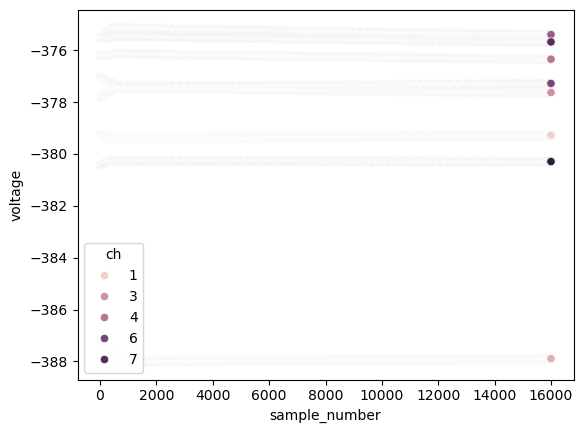

In [3]:
han.quick_scatterplot(df)

(0.0, 0.5)

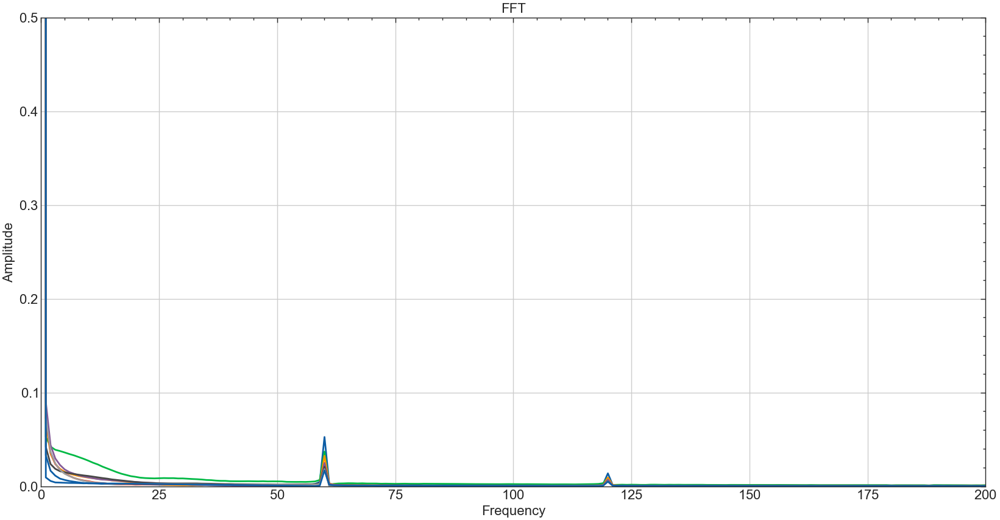

In [39]:
N = df.sample_number.max()
# sample spacing
T = 1.0 / N

plt.figure(figsize=(20,10))
for i in df2.ch.unique():
    yf = fft(df2.loc[df2.ch.eq(i), 'voltage'].values)
    xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
    plt.plot(xf, 2.0/N * np.abs(yf[0:N//2]), label=f'ch{i:02d}')
plt.grid()
plt.title('FFT')
plt.xlabel('Frequency')
plt.ylabel('Amplitude')
plt.xlim(0, 200)
plt.ylim(0,0.5)

(0.0, 200.0)

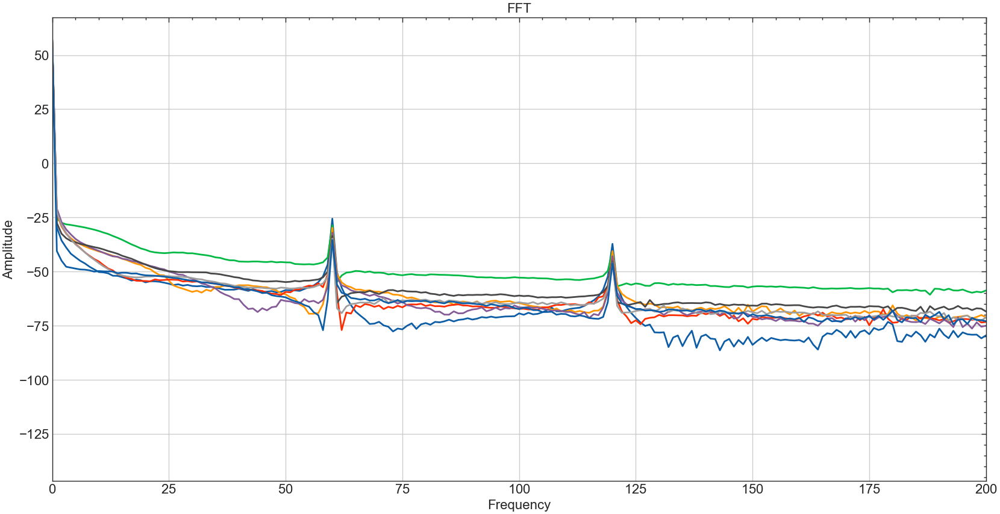

In [40]:
N = df.sample_number.max()
# sample spacing
T = 1.0 / N

plt.figure(figsize=(20,10))
for i in df2.ch.unique():
    yf = fft(df2.loc[df2.ch.eq(i), 'voltage'].values)
    xf = np.linspace(0.0, 1.0/(2.0*T), N//2)
    plt.plot(xf, 20*np.log10(2.0/N * np.abs(yf[0:N//2])), label=f'ch{i:02d}')
plt.grid()
plt.title('FFT')
plt.xlabel('Frequency')
plt.ylabel('Amplitude')
plt.xlim(0, 200)
# plt.ylim(0,0.5)

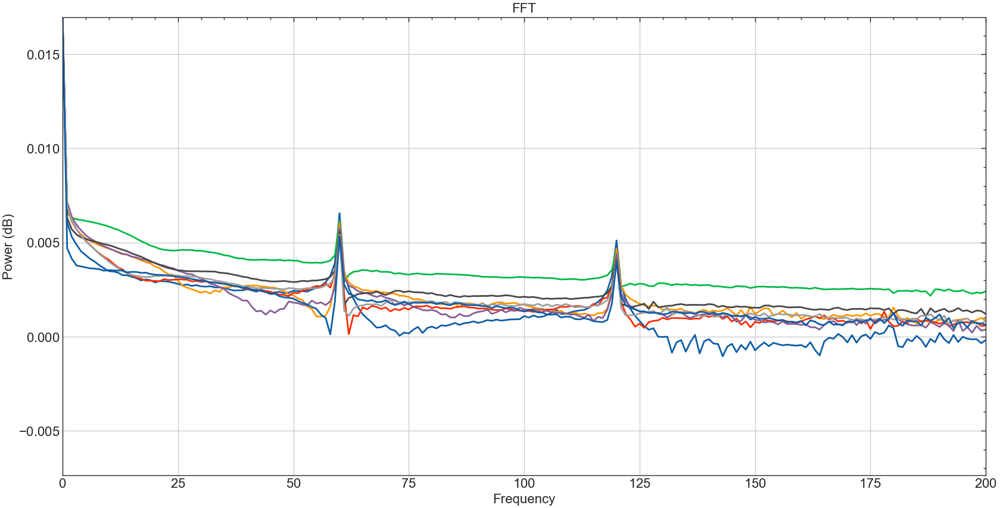

In [3]:
han.quick_fftplot(df, scale='dB')

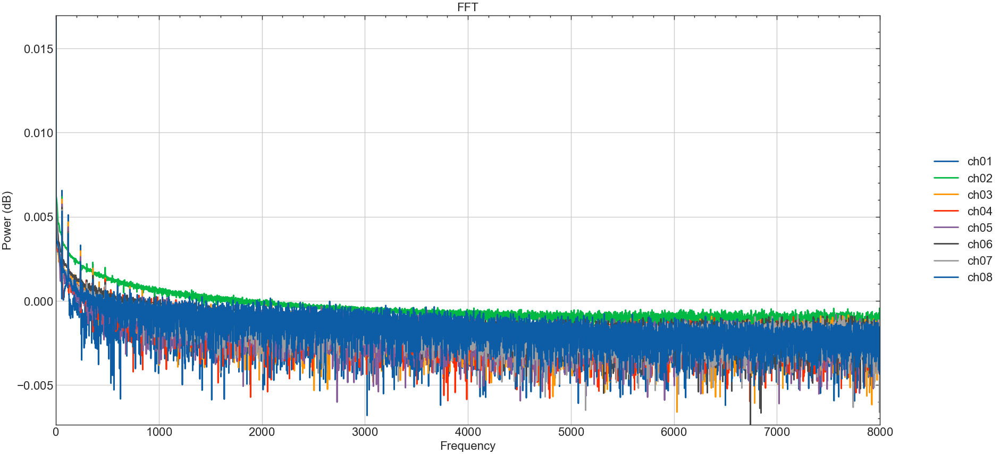

In [3]:
han.quick_fftplot(df, scale='dB')

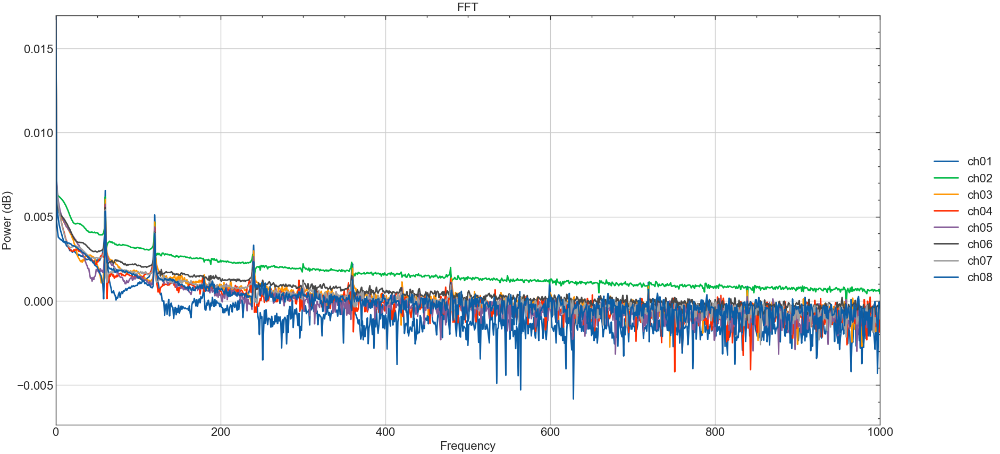

In [3]:
han.quick_fftplot(df, scale='dB', xlim=1000)